In [28]:

def kalyvotree(tree, show_plot=True, export_filename=None, show_labels=False, align_labels=False, label_fontsize=8, start_time=0, default_color='#000000', xlabel=None, handles=None):
        '''Draw this ``Tree`

        Args:
            ``show_plot`` (``bool``): ``True`` to show the plot_ otherwise ``False``

            ``export_filename`` (``str``): File to which the tree figure will be exported (otherwise ``None`` to not save to file)

            ``show_labels`` (``bool``): ``True`` to show the leaf labels_ otherwise ``False``

            ``align_labels`` (``bool``): ``True`` to align the leaf labels (if shown)_ otherwise ``False`` to just put them by their tips

            ``label_fontsize`` (``int``): Font size of the leaf labels (in points). 8pt = 1/9in --> 1in = 72pt

            ``default_color`` (``str``): The default color to use if a node doesn't have a ``color`` attribute

            ``xlabel`` (``str``): The label of the horizontal axis in the resulting plot

            ``handles`` (``list``): List of matplotlib ``Patch`` objects for a legend
        '''
        import matplotlib.pyplot as plt
        from matplotlib.ticker import MaxNLocator
        from matplotlib import rcParams
        orig = {k: rcParams[k] for k in ['axes.spines.left', 'axes.spines.right','axes.spines.top']}
        rcParams['axes.spines.left'] = False # hide left spine
        rcParams['axes.spines.right'] = False # hide right spine
        rcParams['axes.spines.top'] = False # hide top spine

        # compute total height needed at each node
        dy = {}
        for node in tree.traverse_postorder():
            if node.is_leaf():
                dy[node] = 1
            else:
                dy[node] = sum(dy[child] for child in node.children)

        # compute y-coordinate of each node
        y = {tree.root:0} # root is at y = 0
        for node in tree.traverse_preorder(leaves=False):
            y_top = y[node] + (dy[node]/2)
            for i in range(len(node.children)):
                y[node.children[i]] = y_top - (dy[node.children[i]]/2)
                y_top -= dy[node.children[i]]

        # compute x-coordinate of each node
        x = {}
        for node in tree.traverse_preorder():
            if node.is_root():
                x[node] = start_time
            else:
                x[node] = x[node.parent]
            if node.edge_length is not None:
                x[node] += node.edge_length

        # compute width and height
        width = 10 # arbitrary choice
        if show_labels:
            height_per_leaf = label_fontsize/50. # arbitrarily chose 50 to get it to look nice
        else:
            height_per_leaf = 5./50.
        height = 2./8. # height of x-axis is around 2/8 of an inch
        height += dy[tree.root] * height_per_leaf # add tree height
        if xlabel is not None:
            height += 1./8. # height of x-label is around 1/8 of an inch
        height += 4./8. # arbitrary additional padding to get it to look nice for smaller graphs

        # plot tree
        fig, ax = plt.subplots(figsize=(width,height))
        ax.ticklabel_format(useOffset=False) # disable +- from center
        ax.get_yaxis().set_visible(False) # hide y-axis
        for node in tree.traverse_preorder():
            if hasattr(node, 'color') and node.color is not None:
                curr_color = node.color
            else:
                curr_color = default_color
            if node.edge_length is None:
                el = 0
            else:
                el = node.edge_length
            ax.plot([x[node]-el, x[node]], [y[node], y[node]], color=curr_color) # horizontal line into node
            if len(node.children) > 1:
                ax.plot([x[node],x[node]], [y[node.children[0]], y[node.children[-1]]], color=curr_color)
            if show_labels:
                plt.text(x[node], y[node], f" {str(node)}", fontsize=label_fontsize, verticalalignment='center', color=curr_color)

        # show/export
        if xlabel is not None:
            plt.xlabel(xlabel)
        if handles is None:
            legend = None
        else:
            legend = plt.legend(handles=handles, loc='upper right', bbox_to_anchor=(0,1))
        plt.tight_layout()
        if show_plot:
            plt.show()
        if export_filename is not None:
            if legend is None:
                plt.savefig(export_filename)
            else:
                plt.savefig(export_filename, bbox_extra_artists=(legend))
        plt.close()
        for k in orig:
            rcParams[k] = orig[k]

In [143]:
import matplotlib.pyplot as plt
import numpy as np
import random
# import abcpy
import treeswift
from treeswift import Tree, Node
import argparse
import csv
# import UltrametricConversion
from UltrametricConversion import traverse_and_run_average
from UltrametricConversion import transform_data
from UltrametricConversion import normalise_data
from UltrametricConversion import handle_labelless_trees
from UltrametricConversion import handle_none_edge_trees
from typing import Dict, Iterable, List
import os

# create an argparse parser
parser = argparse.ArgumentParser(description="Simulate population and tree")

# add arguments for the simulation parameters
parser.add_argument("--N", type=int, help="population size")
parser.add_argument("--generations", type=int, required=False, help="number of generations to simulate")
parser.add_argument("--disease", type=int, help="number of generations the disease starts")
parser.add_argument("--mut_samples", type=int, required=False, help="number of mutation samples")
parser.add_argument("--s", type=float, help="selection coefficient")
parser.add_argument("--mu", type=float, help="mutation rate")
parser.add_argument("--epsilon", type=float, help="Epsilon Threshold")
parser.add_argument('--output_path', type=str, default='.', help='output path')
parser.add_argument('--observed_data_path', type=str, default='.', help='observed_data_path', required=False)


# parse the command-line arguments
args = parser.parse_args()


class Population:
    def __init__(self, N, generations, disease, s):
        self.N = N
        self.s = s
        self.generations = generations
        self.disease = disease
        self.generation_data = []

    def __str__(self):
        return f"Population size: {self.N}, Generations: {self.generations}, Disease_Onset: {self.disease}, Selection: {self.s}"

    def simulate_population(self):
        """
        Simulate the population using the Wright-Fisher model with selection.
        """

        # Initialize the first population
        population = np.zeros(self.N, dtype=int)
        self.generation_data.append(population)
        binom_prob_list = []
        mut_n_list = []

        for gen in range(1, self.generations + 1):
            print(gen)
            if gen - 1 < len(self.generation_data) and len(self.generation_data) > 0:
                if gen < self.disease:
                    self.generation_data.append(np.zeros(self.N))
                    mut_n_list.append(0)
                    binom_prob_list.append(0)
                elif gen == self.disease:
                    # first cell with mutation
                    population[random.randint(0, self.N - 1)] = 1
                    self.generation_data.append(population)

                    print("Disease started")
                    new_population = np.copy(population)
                    new_population[random.randint(0, self.N - 1)] = 1
                    self.generation_data.append(new_population)

                elif gen > self.disease:
                    # clonal expansion
                    print("Expansion started")
                    print(f"Length self.gen.data: {len(self.generation_data)}")
                    print(self.generation_data[gen - 1])
                    mut_n = len(np.where(self.generation_data[gen - 1] == 1)[0])
                    print(mut_n)
                    mut_n_list.append(mut_n)

                    cancer_p = (1 + self.s) * mut_n / (self.N + (mut_n * self.s))
                    if cancer_p > 1:
                        break
                    binom_prob_list.append(cancer_p)

                    offspring = np.random.binomial(n=1, p=cancer_p, size=mut_n)

                    num_mutants = [np.count_nonzero(offspring == 1)]

                    if num_mutants == 0:
                        # print("Stochastic Extinction")
                        self.generation_data.append(offspring)
                        num_mutants = [np.count_nonzero(generation == 1) for generation in self.generation_data]
                        # Plot the number of mutants over time
                        fig, ax = plt.subplots()
                        ax.plot(range(len(num_mutants)), np.log(num_mutants))
                        ax.set_xlabel("Time in Generations")
                        ax.set_ylabel("Number of mutants ln(N)")
                        ax.set_title(f"Mutant allele frequency over time (s={self.s})")
                        return (self.generation_data, binom_prob_list, mut_n_list, fig)

                    self.generation_data.append(offspring)

        # for gen in range(self.generations):
        #     mut_n = len(np.where(self.generation_data[gen] == 1)[0])
        #     mut_n_list.append(mut_n)

        #     cancer_p = (1 + self.s) * mut_n / (self.N + (mut_n * self.s))
        #     binom_prob_list.append(cancer_p)

        #     offspring = np.random.binomial(n=1, p=cancer_p, size=self.N)

        #     num_mutants = [np.count_nonzero(offspring == 1)]

        #     if num_mutants == 0:
        #         print("Stochastic Extinction")
        #         self.generation_data.append(offspring)
        #         num_mutants = [np.count_nonzero(generation == 1) for generation in self.generation_data]
        #         # Plot the number of mutants over time
        #         fig, ax = plt.subplots()
        #         ax.plot(range(len(num_mutants)), np.log(num_mutants))
        #         ax.set_xlabel("Time in Generations")
        #         ax.set_ylabel("Number of mutants ln(N)")
        #         ax.set_title(f"Mutant allele frequency over time (s={self.s})")
        #         return(self.generation_data, binom_prob_list, mut_n_list, fig)

        #     self.generation_data.append(offspring)

        # Plot the number of mutants over time
        # Count the number of individuals with a value of 1 in each generation
        num_mutants = [np.count_nonzero(generation == 1) for generation in self.generation_data]

        # Plot the number of mutants over time
        fig, ax = plt.subplots()
        ax.plot(range(len(num_mutants)), np.log(num_mutants))
        ax.set_xlabel("Time in Generations")
        ax.set_ylabel("Number of mutants ln(N)")
        ax.set_title(f"Mutant allele frequency over time (s={self.s})")

        return (self.generation_data, binom_prob_list, mut_n_list, fig)


# def build_leaf_to_root_connections(tree_mask, mut_samples):
#     '''
#     Simulate the population using the Wright-Fisher model with selection.

#     Refactors to consider:
#     - Remove leaf to follow mechanism and just early out when we connect to existing geneology
#     '''
#     # List of each generation_ where each generation is a dict from node_idx
#     gen_to_node_idxs_to_children: List[Dict[str, List[str]]] = []
#     desired_number = mut_samples

#     # Initialize the list of generations
#     for generation_idx, generation in enumerate(tree_mask):
#         gen_to_node_idxs_to_children.append({})
#         for node_idx, node in enumerate(generation):
#             if node == 1:
#                 gen_to_node_idxs_to_children[-1][node_idx] = set()

#     assert desired_number <= len(gen_to_node_idxs_to_children[-1])
#     gen_to_node_idxs_to_children[-1] = {
#         id: set()
#         for id in np.random.choice(
#             list(gen_to_node_idxs_to_children[-1].keys()),
#             desired_number,
#             replace=False
#         )
#     }

#     # Go backward from leaf to root_ randomly assigning each leaf to a parent
#     for leaf_idx in gen_to_node_idxs_to_children[-1].keys(): # this loop iterates over each leaf
#         leaf_to_follow = None
#         for generation_idx, generation in reversed( # this inner loop traverses the generations in reverse order excluding the most recent one.
#                 list(enumerate(gen_to_node_idxs_to_children[:-1]))
#         ):
#             if not generation:  # Skip if the generation has no nodes
#                 print('No mutants yet')
#                 continue
#                 # If we already have a leaf to follow pick it's ancestor otherwise pick a random one
#             if leaf_to_follow is not None:
#                 parent_idx = next(
#                     node
#                     for node, leaves in generation.items()
#                     if leaf_to_follow in leaves 
#                 )
#             else:
#                 possible_parents = generation.keys()
#                 possible_parents = [node_idx for node_idx, in possible_parents if len(generation[node_idx]) < 2]
#                 parent_idx = random.choice(possible_parents)

#             # If the parent already has a leaf_ pick it's ancestor in all previous generations to avoid cycles
#             if len(gen_to_node_idxs_to_children[generation_idx][parent_idx]) > 0:
#                 leaf_to_follow = list(gen_to_node_idxs_to_children[generation_idx][parent_idx])[0]

#             # Add the leaf to the parent
#             gen_to_node_idxs_to_children[generation_idx][parent_idx].add(
#                 (len(gen_to_node_idxs_to_children) - 1, leaf_idx)
#             )

#     # Drop any non leaves that weren't connected
#     # Create a dict from node coordinates to leaf coordinates
#     leaves_to_nodes = {}  # Dictionary to store the mapping from leaf coordinates to node coordinates

#     for generation_idx, generation in enumerate(gen_to_node_idxs_to_children):
#         for node_idx, leaves in generation.items():
#             if generation_idx == len(gen_to_node_idxs_to_children) - 1 or len(leaves) > 0:
#                 result_key = f"{generation_idx}_{node_idx}"
#                 for leaf in leaves:
#                     if str(leaf) in leaves_to_nodes:
#                         leaves_to_nodes[str(leaf)].append(result_key)
#                     else:
#                         leaves_to_nodes[str(leaf)] = [result_key]


#     # result = {}

#     # for generation_idx, generation in enumerate(node_to_leaves):
#     #     for node_idx, leaves in generation.items():
#     #         if generation_idx == len(node_to_leaves) - 1 or len(leaves) > 0:
#     #             result_key = f"{generation_idx}_{node_idx}"
#     #             result_value = {f"{leaf[0]}_{leaf[1]}" for leaf in leaves}
#     #             #result_value = {f"{str(leaf)}" for leaf in leaves}
#     #             result[result_key] = result_value

#     return leaves_to_nodes

def build_leaf_to_root_connections(
    tree_mask: Iterable[Iterable[int]],
    mut_samples: int,
) -> Dict[str, List[str]]:
    """
    Simulate the population using the Wright-Fisher model with selection. The simulated
    geneologies allows only two descendants per cell.

    tree_mask: which is a list of lists, representing a matrix where each row is
    a generation and a value of 1 represents a mutated sample and 0 is a normal sample.

    Returns:
        A dictionary of num_samples mutated cells to their geneology (path to root)
        Cells are named with the convention <generation>-<index>
    """
    # TODO: WE ASSUME THAT STOCHASTIC EXTINCTION ISN"T POSSIBLE, WE SHOULD EITHER MAKE SURE THAT"S TRUE, OR MAKE THIS ROBUST TO IT (FIX POSSIBLE_CHILDREN = 0) 
    
    # Assertion that the last generation has a higher number of mut_cells than the desired_number of tips for the sim_tree
    assert sum(tree_mask[-1]) >= mut_samples

    max_children = 20

    # Convert the tree mask into list of generations which are sets of node names
    generation_to_nodes: List[Set[str]] = [
        {f"{gen_idx}-{node_idx}" for node_idx, node in enumerate(gen) if node == 1}
        for gen_idx, gen in enumerate(tree_mask)
    ]

    # Construct mappings of nodes to their children and parents
    node_to_children: Dict[str, Set[str]] = {}
    node_to_parent: Dict[str, str] = {}
    for generation in generation_to_nodes:
        for node in generation:
            node_to_children[node] = set()
            node_to_parent[node] = None

    # Find the root node (not necessarily in the first generation if there are empty generations)
    last_gen = None
    for generation_idx, generation in reversed(list(enumerate(generation_to_nodes))):
        if len(generation) == 0:
            if last_gen is not None:
                break
            else:
                continue                
        last_gen = generation
        last_gen_idx = generation_idx
    assert len(last_gen) == 1
    root = next(iter(last_gen))
    root_gen = last_gen_idx

    # Simulate num_samples geneologies from root to a leaf
    leaves_to_path_to_root: Dict[str, List[str]] = {}
    while len(leaves_to_path_to_root) < mut_samples:
        path = [root]
        for generation in generation_to_nodes[root_gen + 1 :]:
            node = path[0]

            # If the node already has max children, we must choose one of them
            # Otherwise, choose a node any node which doesn't yet have a parent
            possible_children = [n for n in generation if node_to_parent[n] is None]
            if len(node_to_children[node]) == max_children or len(possible_children) == 0:
                assert len(node_to_children[node]) > 0
                possible_children = list(node_to_children[node])
            
            if len(possible_children) == 0:
                break

            # Filter possible children to ones which don't yet have max children
            available_children = [
                n for n in possible_children if len(node_to_children[n]) < max_children
            ]
            if len(available_children) > 0:
                possible_children = available_children

            # Choose a random child and add it to the path to the root
            child = random.choice(possible_children)
            path.insert(0, child)

        # If the path is unique, connect all parents and children and add the path
        leaf = path.pop(0)
        if leaf not in leaves_to_path_to_root:
            child = leaf
            for node in path:
                assert node_to_parent[child] is None or node_to_parent[child] == node
                node_to_children[node].add(child)
                node_to_parent[child] = node
                child = node
            leaves_to_path_to_root[leaf] = path

    return leaves_to_path_to_root

def clusters_to_nodes(tree_clusters: Dict[Node, Iterable[Node]]) -> Tree:
    """
    Input: Dictionary from Leaf nodes to a list of nodes from that leaf to the root
    Output: Tree Object, all nodes with immediate parent and children
    """
    label_to_node = {leaf: Node(label=leaf) for leaf in tree_clusters}

    for leaf_label, parent_labels in tree_clusters.items():
        leaf_node = label_to_node[leaf_label]
        prev_parent = leaf_node
        #for parent_label in reversed(parent_labels):
        for parent_label in parent_labels:
            parent_node = label_to_node.get(parent_label)
            if parent_node is None:
                parent_node = Node(label=parent_label)
                label_to_node[parent_label] = parent_node

            # Connect the new parent to its child (Previous parent)
            if prev_parent not in parent_node.child_nodes():
                parent_node.add_child(prev_parent)
            prev_parent = parent_node

    # Select the element from label_to_node based on label starting from 0
    selected_node_label = None
    first_leaf, path_for_first_leaf = next(iter(tree_clusters.items()))
    selected_node_label = path_for_first_leaf[-1]  # this will give you the last node in the path for the first leaf
    print(f"This the root: {selected_node_label}")
    selected_node = label_to_node[selected_node_label]

    # Create the tree using TreeSwift
    tree = Tree()
    tree.root = selected_node

    return tree


def assign_edge_lengths(mu, tree, disease_onset):
    """
    Iterate through the tree class and assign edge lengths based on a Poisson distribution with mean rate μ.
    """

    one_cell_gens = disease_onset

    first_node = True # to identify the root node

    for node in tree.traverse_preorder():
        if first_node:
            length = np.random.poisson(mu) * one_cell_gens
            first_node = False
            print(f'The root length is:{length}')
        else:
            length = np.random.poisson(mu)
            print(node.label)
            print(f'The node length is:{length}')
        node.set_edge_length(length)
    return tree

def read_observed_data(observed_data_path):
    """
    Read observed tree and calculate LTT statistics and return or read in LTT statistics straight
    """

    # Define the path to the file containing the tree
    tree_file = observed_data_path

    # Load the tree from the TSV file
    with open(tree_file) as f:
        tree_str = f.read()
    tree = treeswift.read_tree_newick(tree_str)
    handle_labelless_trees(tree)
    handle_none_edge_trees(tree)
    normalised_obs_tree = traverse_and_run_average(tree)
    # Calculate lineage through time plot statistics
    ltt = normalised_obs_tree.lineages_through_time(show_plot=False) #, export_filename=f"{output_path}/Plot_obs_ltt_ultrametric_(s={s}).png")
    #ltt = normalised_obs_tree.lineages_through_time(show_plot=False, export_filename=f"{output_path}/Plot_obs_ltt_ultrametric_(s={s}).png")
    list_of_tuples_obs = [(key, value) for key, value in ltt.items()]
    data_transformed_obs = transform_data(list_of_tuples_obs)
    norm_ltt = normalise_data(data_transformed_obs)

    return tree, norm_ltt


from scipy.integrate import trapz

def calculate_epsilon(norm_data1, norm_data2):

    curve1 = norm_data1
    curve2 = norm_data2

    # Extract x and y values for each curve
    x_curve1, y_curve1 = zip(*curve1)
    x_curve2, y_curve2 = zip(*curve2)

    # Create a common range of x-values
    x_common = np.linspace(min(min(x_curve1), min(x_curve2)), max(max(x_curve1), max(x_curve2)), 1000)

    # Interpolate y-values for each curve at the common x-values
    y_interp_curve1 = np.interp(x_common, x_curve1, y_curve1)
    y_interp_curve2 = np.interp(x_common, x_curve2, y_curve2)

    # Find intervals where one curve is above the other
    fill_x = []
    fill_y1 = []
    fill_y2 = []

    for i in range(len(x_common) - 1):
        if y_interp_curve1[i] >= y_interp_curve2[i]:
            fill_x.extend([x_common[i], x_common[i + 1]])
            fill_y1.extend([y_interp_curve1[i], y_interp_curve1[i + 1]])
            fill_y2.extend([y_interp_curve2[i], y_interp_curve2[i + 1]])
        else:
            fill_x.extend([x_common[i], x_common[i + 1]])
            fill_y1.extend([y_interp_curve2[i], y_interp_curve2[i + 1]])
            fill_y2.extend([y_interp_curve1[i], y_interp_curve1[i + 1]])

    # Calculate the area between the curves using the trapezoidal rule
    area_between_curves = trapz(np.abs(np.array(fill_y1) - np.array(fill_y2)), fill_x)

    # Plotting
    fig = plt.figure(figsize=(10, 6))
    plt.plot(x_curve1, y_curve1, label='MPN tree')
    plt.plot(x_curve2, y_curve2, label='Simulation')
    plt.fill_between(fill_x, fill_y1, fill_y2, where=np.array(fill_y1) >= np.array(fill_y2), color='blue', alpha=0.3)
    plt.fill_between(fill_x, fill_y1, fill_y2, where=np.array(fill_y1) < np.array(fill_y2), color='red', alpha=0.3)
    plt.xlabel('Scaled Time')
    plt.ylabel('Lineages')
    plt.title('LTT Curves and Area Between Them')
    plt.legend()
    plt.grid(True)
    plt.ylim(0)  # Set the lower limit of y-axis to 0
    # Add the area between curves value to the plot
    plt.text(0.6, 10, f'Area: {area_between_curves}', fontsize=12)

    return fig, area_between_curves



##### ------------- Wright-Fisher Simulation ------------------------------ ##########

def simulate_population_and_tree(N, generations, disease, mut_samples, s, mu, output_path, observed_d_path, epsilon):
    print("Simulating population...")
    # initiate population
    popul = Population(N, generations, disease, s)
    # go from population array to tree_clusters dictionary
    gen, prob, mut, fig = popul.simulate_population()
    #fig.savefig(f"{output_path}/Simulation_{num_retries}_with_mutants_in_time_(s={s}).png")
    print("Population Done...")
    # create genealogy and save in tree_clusters
    print("Simulating Genealogy...")
    tree_clusters = build_leaf_to_root_connections(gen, mut_samples)
    # create phylo tree
    gen_tree = clusters_to_nodes(tree_clusters)
    from treeswift import read_tree_newick
    tree_string = gen_tree.newick()
    phy_tree = read_tree_newick(tree_string)
    print("Genealogy Done")
    # assign random edge (branch) lengths
    phy_tree_mut = assign_edge_lengths(mu, phy_tree, disease)
    # make tree ultrametric
    handle_labelless_trees(phy_tree_mut)
    handle_none_edge_trees(phy_tree_mut)
    normalised_tree = traverse_and_run_average(phy_tree_mut)
    print("Ultrametric tree done")

    #phy_tree_mut.draw(show_plot=True, export_filename=f"{output_path}/Plot_tree_ultrametric_(s={s}).png")

    # calculate ltt stats and plot using treeswift
    ltt_gen_tree = phy_tree_mut.lineages_through_time(show_plot=False)# export_filename=f"{output_path}/Plot_ltt_ultrametric_(s={s}).png")

#    ltt_gen_tree = phy_tree_mut.lineages_through_time(show_plot=False, export_filename=f"{output_path}/Plot_ltt_ultrametric_(s={s}).png")
    #ltt_gen_tree = phy_tree_mut.lineages_through_time(show_plot=False)
    # with open(f"{output_path}/Simulation_{args.N}_{args.generations}_{args.disease}_{args.mut_samples}_{args.s}_ltt_gen_tree.tsv", "w", newline='') as f:
    #     writer = csv.writer(f, delimiter='\t')
    #     for key, value in ltt_gen_tree.items():
    #         writer.writerow([key, value])
    #print("LTT Saved")

    # normalise ltt stats
    list_of_tuples_tree = [(key, value) for key, value in ltt_gen_tree.items()]
    data_transformed = transform_data(list_of_tuples_tree)
    norm_data = normalise_data(data_transformed)

    # write data to a csv file
    # with open(f"{output_path}/Simulation_{args.N}_{args.generations}_{args.disease}_{args.mut_samples}_{args.s}_ltt_normalised.tsv", "w", newline='') as f:
    #     writer = csv.writer(f, delimiter='\t')
    #     writer.writerow(["Time", "Lineages"])  # Write column headers
    #     writer.writerows(norm_data)
    print("LTT Statistics Done")

    #print("LTT Normalised Saved")

    print("Reading Observed Data and Calculating LTT...")
    obs_tree, obs_ltt = read_observed_data(observed_d_path, output_path, s)
    fig_abc, abc = calculate_epsilon(obs_ltt, norm_data)
    if abc is not None and epsilon is not None and abc < epsilon:
    # Do something
        fig_abc.savefig(f"{output_path}/Simulation_{N}_{disease}_with_abc_fig_(s={s}).png")
    print("Area Under the Curve calculated")

    return phy_tree_mut, abc

ModuleNotFoundError: No module named 'UltrametricConversion'

mut_n = 1, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.00043989442533791894
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0
mut_n = 0, self.s = 1.2, self.N = 5000
Initial cancer_p = 0.0


/var/folders/8w/1btgfy_s143ghsgz9nw2wjp13h5g9x/T/ipykernel_39686/1357226016.py:88: RuntimeWarning: divide by zero encountered in log
  ax.plot(range(len(num_mutants)), np.log(num_mutants))


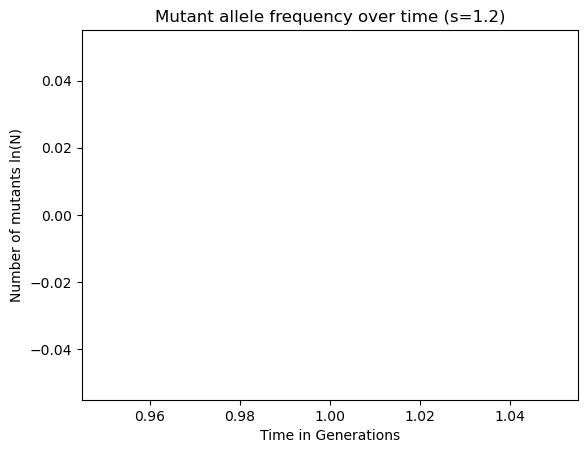

In [142]:
###################################
# check why so many polytomies ###
#################################
# initiate population with 40000 cells, 21 generation, 4 disease onset, s=0.8 and mut_rate=723/21-1)
popul = Population(5000, 10, 1, 1.2)
gen, prob, mut, fig = popul.simulate_population()

In [104]:
prob

[0.004389465283320033, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

In [103]:
mut

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0]

/var/folders/8w/1btgfy_s143ghsgz9nw2wjp13h5g9x/T/ipykernel_39686/2279138025.py:82: RuntimeWarning: divide by zero encountered in log
  ax.plot(range(len(num_mutants)), np.log(num_mutants))


ValueError: No possible children available!

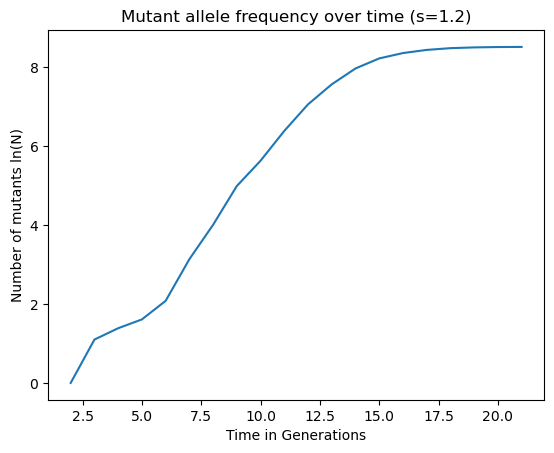

In [32]:
###################################
# check why so many polytomies ###
#################################
# initiate population with 40000 cells, 21 generation, 4 disease onset, s=0.8 and mut_rate=723/21-1)
popul = Population(5000, 20, 2, 1.2)
# #print(popul) 
# # go from population array to tree_clusters dictionary
gen, prob, mut, fig = popul.simulate_population()
pathm, tree_clusters = build_leaf_to_root_connections(gen, 12)
# create phylo tree
gen_tree = clusters_to_nodes(tree_clusters)
# from treeswift import read_tree_newick
tree_string = gen_tree.newick()
phy_tree = read_tree_newick(tree_string)
print('Genealogy Done')
# # assign random edge (branch) lengths
phy_tree_mut = assign_edge_lengths(22, phy_tree, 2)
# phy_tree_mut.write_tree_newick(f'{output_path}/Simulation_{args.N}_{args.generations}_{args.disease}_{args.mut_samples}_{args.s}_output_gen_tree.nwk'_ hide_rooted_prefix=False)
phy_tree_mut.draw(show_labels=True)
print('all done')

In [29]:
pathm

['20-2034',
 '19-3273',
 '18-2686',
 '17-1044',
 '16-1101',
 '15-4988',
 '14-1292',
 '13-3991',
 '12-4093',
 '11-4361',
 '10-1528',
 '9-228',
 '8-4628',
 '7-2872',
 '6-4862',
 '5-3273',
 '4-402',
 '3-1366',
 '2-3559']

In [30]:
tree_clusters

{'21-1605': ['20-931',
  '19-9',
  '18-1719',
  '17-1403',
  '16-335',
  '15-814',
  '14-463',
  '13-1243',
  '12-4370',
  '11-2357',
  '10-1577',
  '9-3',
  '8-2447',
  '7-1485',
  '6-1159',
  '5-2137',
  '4-402',
  '3-1366',
  '2-3559'],
 '21-3097': ['20-2531',
  '19-708',
  '18-4338',
  '17-2002',
  '16-1142',
  '15-2630',
  '14-4616',
  '13-741',
  '12-1113',
  '11-4461',
  '10-639',
  '9-2458',
  '8-3826',
  '7-2852',
  '6-3689',
  '5-4003',
  '4-4912',
  '3-1527',
  '2-3559'],
 '21-1160': ['20-1545',
  '19-3511',
  '18-3736',
  '17-540',
  '16-3434',
  '15-440',
  '14-239',
  '13-4924',
  '12-1188',
  '11-3872',
  '10-2599',
  '9-1111',
  '8-366',
  '7-4574',
  '6-923',
  '5-4997',
  '4-4021',
  '3-1366',
  '2-3559'],
 '21-2602': ['20-2582',
  '19-2301',
  '18-190',
  '17-2704',
  '16-1286',
  '15-2430',
  '14-935',
  '13-768',
  '12-1635',
  '11-510',
  '10-1995',
  '9-1353',
  '8-72',
  '7-2222',
  '6-961',
  '5-4645',
  '4-3376',
  '3-1527',
  '2-3559'],
 '21-4453': ['20-218',

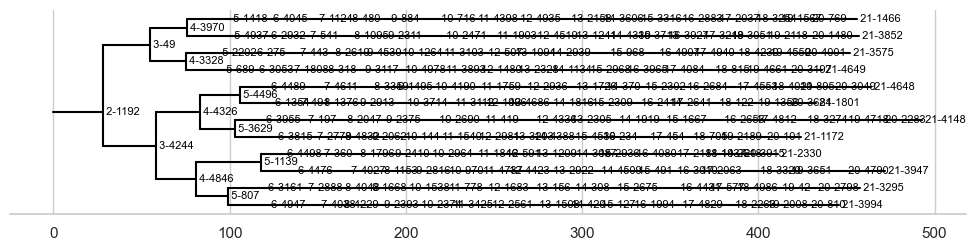

In [208]:
kalyvotree(phy_tree_mut, show_labels=True)

In [213]:
tree_clusters

{'21-1466': ['20-769',
  '19-1567',
  '18-3254',
  '17-2037',
  '16-2883',
  '15-3316',
  '14-3606',
  '13-2158',
  '12-4935',
  '11-4398',
  '10-716',
  '9-884',
  '8-480',
  '7-1124',
  '6-4045',
  '5-1418',
  '4-3970',
  '3-49',
  '2-1192'],
 '21-4648': ['20-3049',
  '19-895',
  '18-4021',
  '17-4553',
  '16-2684',
  '15-2302',
  '14-370',
  '13-1726',
  '12-2936',
  '11-1759',
  '10-4190',
  '9-1495',
  '8-3359',
  '7-4611',
  '6-4489',
  '5-4496',
  '4-4326',
  '3-4244',
  '2-1192'],
 '21-2330': ['20-3915',
  '19-2618',
  '18-1437',
  '17-2181',
  '16-4080',
  '15-2936',
  '14-3087',
  '13-1209',
  '12-591',
  '11-1846',
  '10-2964',
  '9-2410',
  '8-1796',
  '7-360',
  '6-4498',
  '5-1139',
  '4-4846',
  '3-4244',
  '2-1192'],
 '21-3575': ['20-4001',
  '19-4559',
  '18-4230',
  '17-4940',
  '16-4907',
  '15-968',
  '14-2939',
  '13-1094',
  '12-507',
  '11-3103',
  '10-1264',
  '9-4530',
  '8-2619',
  '7-443',
  '6-275',
  '5-2202',
  '4-3328',
  '3-49',
  '2-1192'],
 '21-3852': 

fitness = 0.5500950292172072
population size = 51
generations = 36
disease onset = 27
number of tree tips = 22
mutation_rate = 20.65714285714286
fitness = 0.9472421983770822
population size = 3800
generations = 36
disease onset = 23
number of tree tips = 22
mutation_rate = 20.65714285714286
fitness = 0.15301820971133578
population size = 577
generations = 45
disease onset = 28
number of tree tips = 22
mutation_rate = 16.431818181818183
fitness = 1.4068863318061253
population size = 15410662
generations = 26
disease onset = 16
number of tree tips = 22
mutation_rate = 28.92
fitness = 1.8065528415391747
population size = 8352
generations = 35
disease onset = 10
number of tree tips = 22
mutation_rate = 21.264705882352942
fitness = 0.5687571337368619
population size = 1300481
generations = 39
disease onset = 25
number of tree tips = 22
mutation_rate = 19.026315789473685
fitness = 1.2438654832771776
population size = 10130959
generations = 36
disease onset = 28
number of tree tips = 22
mutat

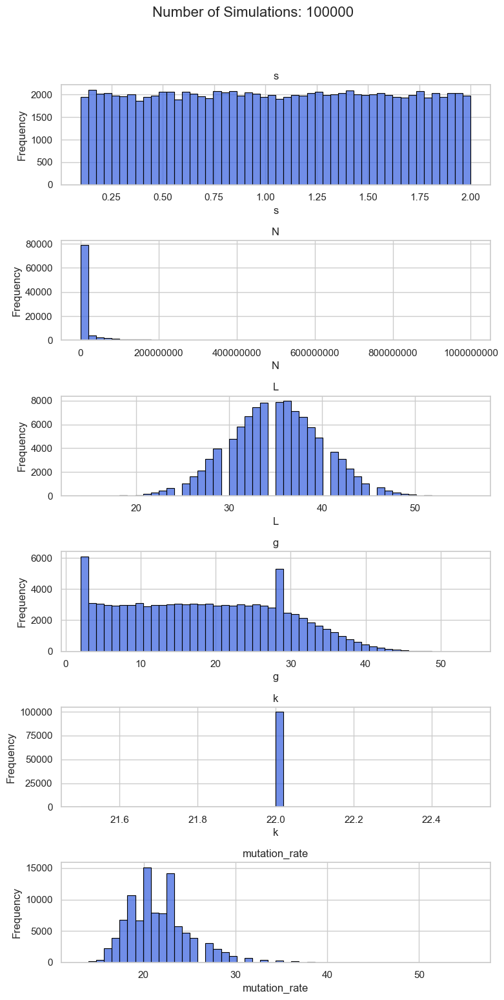

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

# Function to run simulations
def run_simulation():
    # Draw s from a uniform distribution on (0, 2).
    s = np.random.uniform(0.1, 2)

    # Draw N from 10X, where X is uniformly distributed on (1, 9).
    X = np.random.uniform(1,9)
    N = round(10 ** X)

    # Draw L from round(Y), where Y is a Gaussian with mean 35 and std 5.
    L = round(np.random.normal(35, 5))
    while L < 2:  # redraw L until L >= 2
        L = round(np.random.normal(35, 5))

    # Draw g uniformly on the range 2, ..., L.
    g = round(np.random.randint(2, L+1))

    # Set k
    k = 22

    # Calculate mutation rate
    total_length_of_patient_tree = 723
    mutation_rate = total_length_of_patient_tree / (L - 1)

    # Printing the values
    print(f"fitness = {s}")
    print(f"population size = {N}")
    print(f"generations = {L}")
    print(f"disease onset = {g}")
    print(f"number of tree tips = {k}")
    print(f"mutation_rate = {mutation_rate}")
    #print(f"epsilon_threshold = {epsilon_threshold}")

    # Return parameters
    return {
    "s": s,
    "N": N,
    "L": L,
    "g": g,
    "k": k,
    "mutation_rate": mutation_rate
}

#   return s, N, L, g, k, mutation_rate

import os
import glob

num_simulations = 100000
results = [run_simulation() for _ in range(num_simulations)]


# Plot Results #

# Set the style of Seaborn
sns.set(style="whitegrid")

# Parameters to plot
parameters = ["s", "N", "L", "g", "k", "mutation_rate"]

# Create a grid of plots
fig, axs = plt.subplots(len(parameters), 1, figsize=(8, 15))

# Add the number of simulations as the main title
fig.suptitle(f'Number of Simulations: {num_simulations}', y=1.03, fontsize=16)

for ax, param in zip(axs, parameters):
    values = [res[param] for res in results]

    # Increase bins for N variable
    bins = 50 if param == "N" else 50
    # Use Seaborn's histogram (distplot) function
    sns.histplot(values, bins=bins, ax=ax, kde=False, color='royalblue', edgecolor="black")
    
    ax.set_title(param)  # Set title as the parameter name
    ax.set_ylabel("Frequency")
    ax.set_xlabel(param)

    if param == "N":
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.get_xaxis().get_major_formatter().set_useOffset(False)
        #ax.set_xlim(0, 2000000)

plt.tight_layout()
plt.show()

Min: 10
Max: 999638341
Mean: 54429035.83237
Standard Deviation: 155720160.3974859


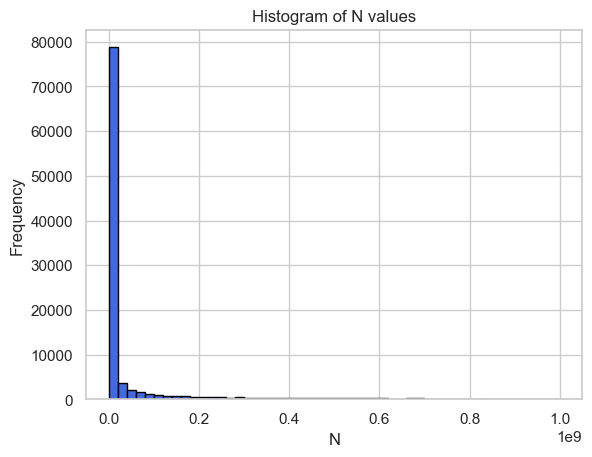

In [47]:
N_values = [res["N"] for res in results]
print("Min:", min(N_values))
print("Max:", max(N_values))
print("Mean:", sum(N_values)/len(N_values))
print("Standard Deviation:", (sum([(n - sum(N_values)/len(N_values))**2 for n in N_values])/len(N_values))**0.5)

import matplotlib.pyplot as plt
plt.hist(N_values, bins=50, color='royalblue', edgecolor="black")
plt.title("Histogram of N values")
plt.xlabel("N")
plt.ylabel("Frequency")
plt.show()


/var/folders/8w/1btgfy_s143ghsgz9nw2wjp13h5g9x/T/ipykernel_10502/4162057476.py:81: RuntimeWarning: divide by zero encountered in log
  ax.plot(range(len(num_mutants)), np.log(num_mutants))


No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants yet
No mutants

IndexError: Cannot choose from an empty sequence

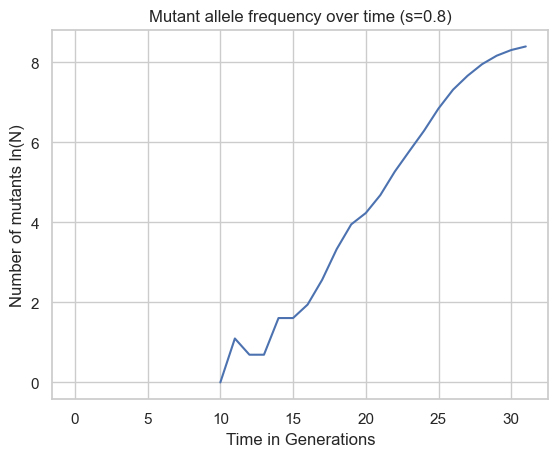

In [94]:
###################################
# check why so many polytomies ###
#################################
# initiate population with 40000 cells, 21 generation, 4 disease onset, s=0.8 and mut_rate=723/21-1)
popul = Population(5000, 30, 10, 0.8)
# #print(popul) 
# # go from population array to tree_clusters dictionary
gen, prob, mut, fig = popul.simulate_population()
tree_clusters = build_leaf_to_root_connections(gen, 22)
# create phylo tree
gen_tree = clusters_to_nodes(tree_clusters)
from treeswift import read_tree_newick
tree_string = gen_tree.newick()
phy_tree = read_tree_newick(tree_string)
print('Genealogy Done')
# # assign random edge (branch) lengths
phy_tree_mut = assign_edge_lengths(36.15, phy_tree, 4)
# phy_tree_mut.write_tree_newick(f'{output_path}/Simulation_{args.N}_{args.generations}_{args.disease}_{args.mut_samples}_{args.s}_output_gen_tree.nwk'_ hide_rooted_prefix=False)
phy_tree_mut.draw(show_labels=True)
print('all done')

In [40]:
mut

[0,
 0,
 0,
 1,
 1,
 4,
 7,
 11,
 19,
 31,
 64,
 115,
 203,
 389,
 697,
 1312,
 2356,
 4098,
 7173,
 11907,
 19222]

In [42]:
prob

[0,
 0,
 0,
 2.2499775002249976e-05,
 2.2499775002249976e-05,
 8.999640014399424e-05,
 0.00015748897577169595,
 0.0002474727779944206,
 0.0004274187904298184,
 0.0006972838420089772,
 0.0014390789894467542,
 0.0025845277930380064,
 0.004558246759079071,
 0.008718584705495623,
 0.015573949571486738,
 0.02913771320277953,
 0.05178983156825198,
 0.08857518876443353,
 0.15059063383501442,
 0.2394019140893778,
 0.3627644226736676]

/var/folders/8w/1btgfy_s143ghsgz9nw2wjp13h5g9x/T/ipykernel_10502/1347705466.py:81: RuntimeWarning: divide by zero encountered in log
  ax.plot(range(len(num_mutants)), np.log(num_mutants))


Genealogy Done
The root length is:99
5_12828
The node length is:27
6_12835
The node length is:28
7_3458
The node length is:28
8_8653
The node length is:15
9_12518
The node length is:25
10_38385
The node length is:20
11_11006
The node length is:26
12_17575
The node length is:22
13_18258
The node length is:35
14_22011
The node length is:30
15_21156
The node length is:29
16_24956
The node length is:23
17_6597
The node length is:25
18_23473
The node length is:28
19_19848
The node length is:22
20_38841
The node length is:27
21_23826
The node length is:33
22_29664
The node length is:40
23_23147
The node length is:18
24_25411
The node length is:25
25_19546
The node length is:26
(26,11527)
The node length is:29
9_4028
The node length is:33
10_37599
The node length is:34
11_2537
The node length is:32
12_29329
The node length is:23
13_11277
The node length is:31
14_33532
The node length is:26
15_28312
The node length is:25
16_38078
The node length is:25
17_38012
The node length is:25
18_7641
The

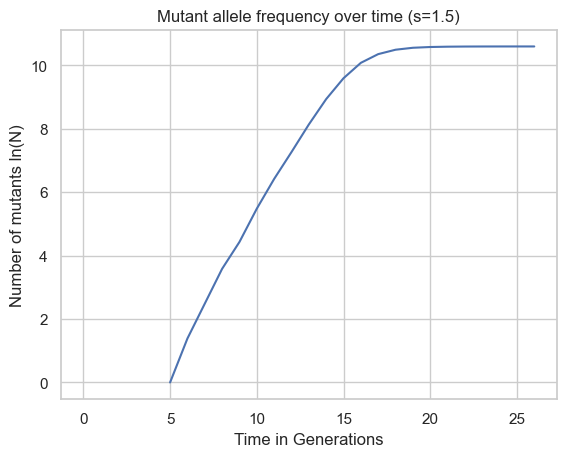

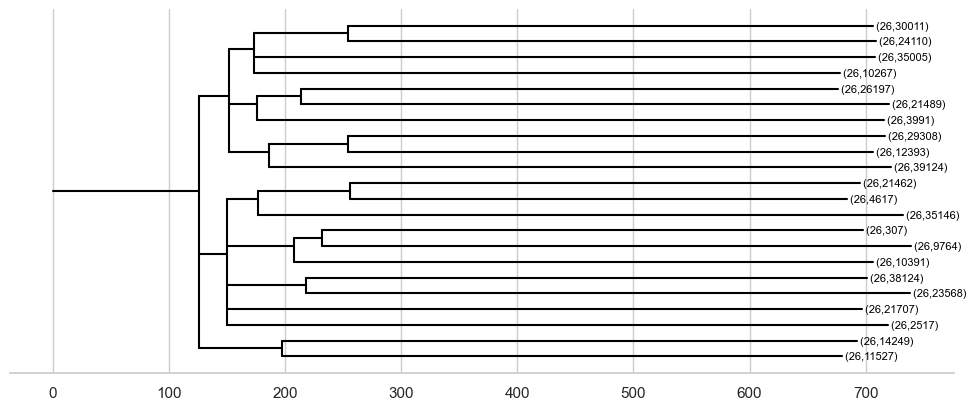

all done


In [66]:
###################################
# check why so many polytomies ###
#################################
# initiate population with 40000 cells, 21 generation, 4 disease onset, s=0.8 and mut_rate=723/21-1)
popul = Population(40000, 25, 5, 1.5)
mut_rate = 723/25-1
# #print(popul) 
# # go from population array to tree_clusters dictionary
gen, prob, mut, fig = popul.simulate_population()
tree_clusters = build_leaf_to_root_connections(gen, 22)
# create phylo tree
gen_tree = clusters_to_nodes(tree_clusters)
from treeswift import read_tree_newick
tree_string = gen_tree.newick()
phy_tree = read_tree_newick(tree_string)
print('Genealogy Done')
# # assign random edge (branch) lengths
phy_tree_mut = assign_edge_lengths(mut_rate, phy_tree, 4)
# phy_tree_mut.write_tree_newick(f'{output_path}/Simulation_{args.N}_{args.generations}_{args.disease}_{args.mut_samples}_{args.s}_output_gen_tree.nwk'_ hide_rooted_prefix=False)
phy_tree_mut.draw(show_labels=True)
print('all done')

In [67]:
mut

[0,
 0,
 0,
 0,
 1,
 4,
 12,
 36,
 84,
 240,
 613,
 1430,
 3414,
 7602,
 14678,
 23859,
 31395,
 36074,
 38362,
 39295,
 39701,
 39879,
 39946,
 39979,
 39990]

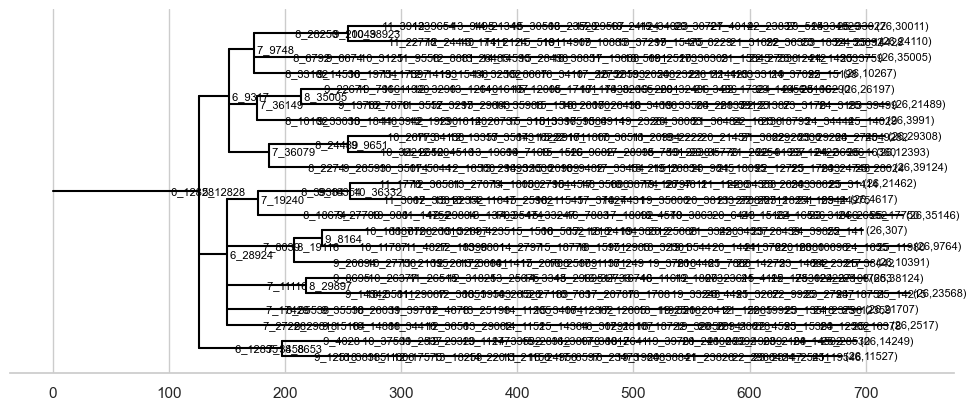

In [68]:
kalyvotree(phy_tree_mut, show_labels=True)